In [6]:
# 📦 필요한 라이브러리 설치 (처음 한 번만 실행)
# !pip install transformers torchaudio torch scikit-learn matplotlib

# 📌 1. 라이브러리 import
from transformers import Wav2Vec2Processor, Wav2Vec2Model
import torchaudio
import torch
import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import os

# 📌 2. 임베딩 추출 함수 (구간별로 나눠서 추출)
import torchaudio.transforms as T

def extract_embeddings(audio_path, processor, model, block_size=1.0):
    waveform, sample_rate = torchaudio.load(audio_path)
    waveform = waveform.mean(dim=0, keepdim=True)  # 모노로 변환

    # ✅ 리샘플링: 16000Hz로 변환
    target_sample_rate = 16000
    if sample_rate != target_sample_rate:
        resampler = T.Resample(orig_freq=sample_rate, new_freq=target_sample_rate)
        waveform = resampler(waveform)
        sample_rate = target_sample_rate

    duration = waveform.shape[1] / sample_rate
    embeddings = []

    for start in np.arange(0, duration, block_size):
        start_sample = int(start * sample_rate)
        end_sample = int(min((start + block_size) * sample_rate, waveform.shape[1]))
        segment = waveform[:, start_sample:end_sample]

        if segment.shape[1] < int(block_size * sample_rate * 0.5):  # 너무 짧으면 스킵
            continue

        inputs = processor(segment.squeeze(), sampling_rate=sample_rate, return_tensors="pt", padding=True)
        with torch.no_grad():
            outputs = model(**inputs)
        emb = outputs.last_hidden_state.mean(dim=1).squeeze().numpy()
        embeddings.append(emb)

    return np.array(embeddings)


# 📌 3. 시각화 함수
def visualize_latent_landscape(embeddings, title="Audio Latent Landscape"):
    tsne = TSNE(n_components=2, perplexity=5, random_state=42)
    reduced = tsne.fit_transform(embeddings)

    # 색상 또는 선으로 시간 흐름 표현
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(reduced[:, 0], reduced[:, 1],
                          c=np.arange(len(reduced)), cmap="viridis", s=50, alpha=0.8)
    plt.plot(reduced[:, 0], reduced[:, 1], color='gray', alpha=0.3, linestyle='--')
    plt.title(title)
    plt.colorbar(scatter, label="Segment Index (Time)")
    plt.xlabel("t-SNE 1")
    plt.ylabel("t-SNE 2")
    plt.grid(True)
    plt.show()

# 📌 4. 실행 부분
def run_audio_latent_landscape(audio_path, title="Audio Landscape"):
    print(f"🔍 Processing: {audio_path}")
    processor = Wav2Vec2Processor.from_pretrained("facebook/wav2vec2-base")
    model = Wav2Vec2Model.from_pretrained("facebook/wav2vec2-base")
    model.eval()

    embeddings = extract_embeddings(audio_path, processor, model)
    visualize_latent_landscape(embeddings, title=title)


🔍 Processing: C:\Users\VISLAB-seongwon\Desktop\Sonar\shipsear, deepship\June2016_ShipsEar an underwater vessel noise database\Class_A\15__10_07_13_radaUno_Pasa.wav


C:\Users\VISLAB-seongwon\miniconda3\envs\sonar\lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] 지정된 파일을 찾을 수 없습니다
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "C:\Users\VISLAB-seongwon\miniconda3\envs\sonar\lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
  File "C:\Users\VISLAB-seongwon\miniconda3\envs\sonar\lib\subprocess.py", line 505, in run
    with Popen(*popenargs, **kwargs) as process:
  File "C:\Users\VISLAB-seongwon\miniconda3\envs\sonar\lib\subprocess.py", line 951, in __init__
    self._execute_child(args, executable, preexec_fn, close_fds,
  File "C:\Users\VISLAB-seongwon\miniconda3\envs\sonar\lib\subprocess.py", line 1436, in _execute_child
    hp, ht, pid, tid = 

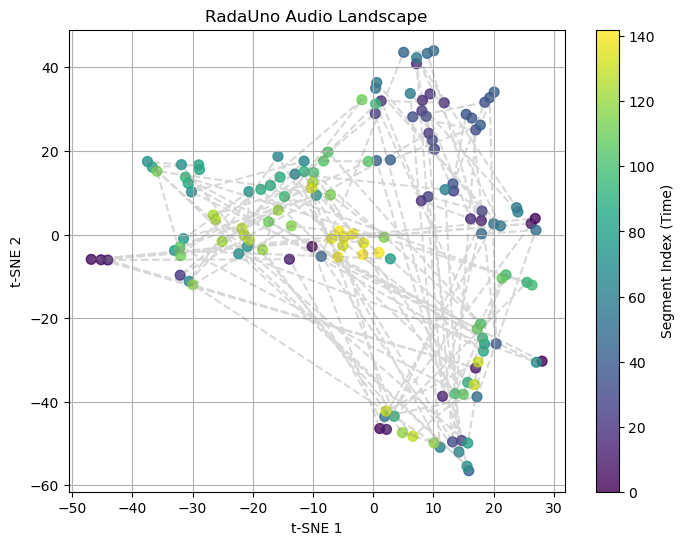

In [7]:
audio_path = r"C:\Users\VISLAB-seongwon\Desktop\Sonar\shipsear, deepship\June2016_ShipsEar an underwater vessel noise database\Class_A\15__10_07_13_radaUno_Pasa.wav"  # 원하는 경로로 수정
run_audio_latent_landscape(audio_path, title="RadaUno Audio Landscape")

In [11]:
import os
import torchaudio
import torch
import numpy as np
from tqdm import tqdm  # 진행 표시줄
import torchaudio.transforms as T
import torchvision.models as models
import torch.nn as nn

def extract_cnn_features(audio_tensor, sample_rate):
    mel_spec = T.MelSpectrogram(sample_rate=sample_rate)(audio_tensor)
    mel_spec = mel_spec.log2().unsqueeze(0)  # (1, 1, freq, time)

    resnet = models.resnet18(pretrained=True)
    resnet.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)  # 수정
    feature_extractor = nn.Sequential(*list(resnet.children())[:-2])  # 마지막 FC 제거

    with torch.no_grad():
        features = feature_extractor(mel_spec)
    return features.squeeze().numpy()

def show_feature_map(features, title="Feature Map"):
    plt.figure(figsize=(12, 6))
    averaged = features.mean(axis=0)  # 채널 평균
    plt.imshow(averaged, aspect='auto', origin='lower', cmap='viridis')
    plt.title(title)
    plt.colorbar(label="Activation")
    plt.tight_layout()
    plt.show()

# 오디오 파일 1개 처리 및 시각화
def run_visualization_for_audio(audio_path):
    audio_tensor, sr = torchaudio.load(audio_path)
    audio_tensor = audio_tensor.mean(dim=0, keepdim=True)

    plt.plot(audio_tensor.squeeze().numpy())
    plt.title("Waveform")
    plt.show()
    features = extract_cnn_features(audio_tensor, sr)
    show_feature_map(features, title=os.path.basename(audio_path))

def process_audio_folder(folder_path, save_dir=None):
    if save_dir and not os.path.exists(save_dir):
        os.makedirs(save_dir)

    feature_list = []
    for file in tqdm(os.listdir(folder_path)):
        if file.endswith(".wav"):
            file_path = os.path.join(folder_path, file)
            try:
                audio_tensor, sr = torchaudio.load(file_path)
                audio_tensor = audio_tensor.mean(dim=0, keepdim=True)  # 모노로 변환

                features = extract_cnn_features(audio_tensor, sr)

                if save_dir:
                    np.save(os.path.join(save_dir, f"{os.path.splitext(file)[0]}_cnn.npy"), features)
                else:
                    feature_list.append((file, features))

            except Exception as e:
                print(f"⚠️ Error processing {file}: {e}")

    if not save_dir:
        return feature_list

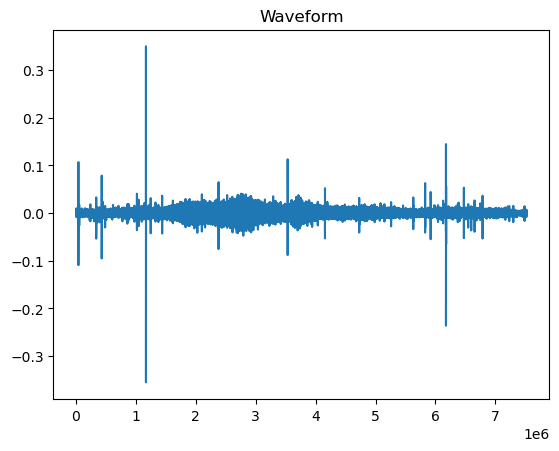

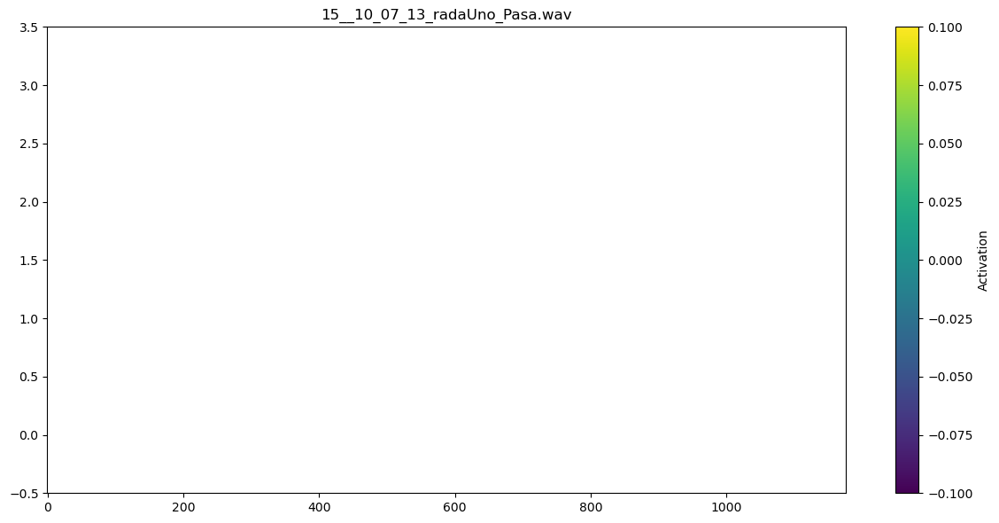

In [12]:
audio_path = r"C:/Users/VISLAB-seongwon/Desktop/Sonar/shipsear, deepship/June2016_ShipsEar an underwater vessel noise database/Class_A/15__10_07_13_radaUno_Pasa.wav"
run_visualization_for_audio(audio_path)

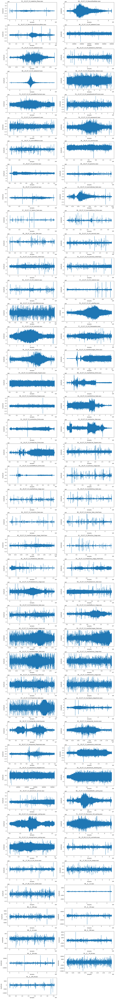

In [13]:
import os
import matplotlib.pyplot as plt
from scipy.io import wavfile

# 분석하고자 하는 최상위 폴더 경로 설정
root_dir = 'C:/Users/VISLAB-seongwon/Desktop/Sonar/shipsear, deepship/June2016_ShipsEar an underwater vessel noise database/'  # 여기에 최상위 폴더 경로를 넣어주세요

# .wav 파일 경로 수집
wav_paths = []
for subdir, _, files in os.walk(root_dir):
    for file in files:
        if file.endswith(".wav"):
            wav_paths.append(os.path.join(subdir, file))

# 서브플롯 설정
num_files = len(wav_paths)
cols = 2  # 컬럼 수 (원하는 대로 조절 가능)
rows = (num_files + cols - 1) // cols

fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 3))
axs = axs.flatten()

# 웨이브폼 그리기
for i, wav_path in enumerate(wav_paths):
    try:
        rate, data = wavfile.read(wav_path)
        axs[i].plot(data)
        axs[i].set_title(os.path.basename(wav_path))
        axs[i].set_xlabel('Samples')
        axs[i].set_ylabel('Amplitude')
    except Exception as e:
        axs[i].text(0.5, 0.5, f"Error reading file:\n{os.path.basename(wav_path)}",
                    ha='center', va='center')
        axs[i].set_title('Error')

# 남는 서브플롯 숨기기
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


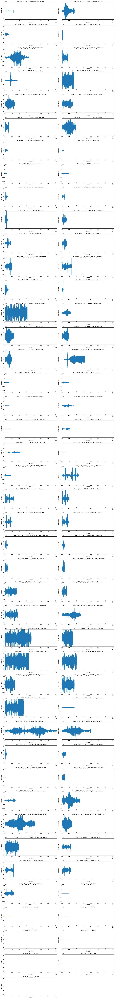

In [14]:
import os
import matplotlib.pyplot as plt
from scipy.io import wavfile
import numpy as np

# 최상위 폴더 경로 설정
root_dir = 'C:/Users/VISLAB-seongwon/Desktop/Sonar/shipsear, deepship/June2016_ShipsEar an underwater vessel noise database/'  # 예: './wav_data'

# .wav 파일 경로 수집
wav_paths = []
for subdir, _, files in os.walk(root_dir):
    for file in files:
        if file.endswith(".wav"):
            wav_paths.append(os.path.join(subdir, file))

# 서브플롯 설정
num_files = len(wav_paths)
cols = 2
rows = (num_files + cols - 1) // cols

fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 3))
axs = axs.flatten()

# 전체 웨이브폼의 최대 길이 및 진폭 범위 계산
max_len = 0
max_amp = 0
for wav_path in wav_paths:
    rate, data = wavfile.read(wav_path)
    if data.ndim > 1:  # 스테레오 → 모노
        data = data.mean(axis=1)
    max_len = max(max_len, len(data))
    max_amp = max(max_amp, np.abs(data).max())

# 웨이브폼 그리기 (축 동일하게 유지)
for i, wav_path in enumerate(wav_paths):
    try:
        rate, data = wavfile.read(wav_path)
        if data.ndim > 1:
            data = data.mean(axis=1)

        axs[i].plot(data)
        axs[i].set_xlim(0, max_len)
        axs[i].set_ylim(-max_amp, max_amp)

        # 상위 폴더 이름 + 파일명 출력
        parent_folder = os.path.basename(os.path.dirname(wav_path))
        file_name = os.path.basename(wav_path)
        axs[i].set_title(f"{parent_folder}/{file_name}")

        axs[i].set_xlabel('Samples')
        axs[i].set_ylabel('Amplitude')

    except Exception as e:
        axs[i].text(0.5, 0.5, f"Error reading:\n{os.path.basename(wav_path)}",
                    ha='center', va='center')
        axs[i].set_title('Error')
        axs[i].axis('off')

# 남는 서브플롯 숨기기
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()


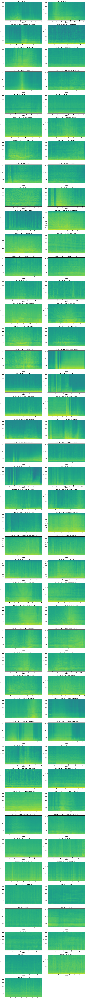

In [15]:
import os
import matplotlib.pyplot as plt
from scipy.io import wavfile
import numpy as np

# 최상위 폴더 경로 설정
root_dir = 'C:/Users/VISLAB-seongwon/Desktop/Sonar/shipsear, deepship/June2016_ShipsEar an underwater vessel noise database/'

# .wav 파일 경로 수집
wav_paths = []
for subdir, _, files in os.walk(root_dir):
    for file in files:
        if file.endswith(".wav"):
            wav_paths.append(os.path.join(subdir, file))

# 서브플롯 설정
num_files = len(wav_paths)
cols = 2
rows = (num_files + cols - 1) // cols

fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 4))
axs = axs.flatten()

# 스펙트로그램 그리기
for i, wav_path in enumerate(wav_paths):
    try:
        rate, data = wavfile.read(wav_path)
        if data.ndim > 1:
            data = data.mean(axis=1)  # 스테레오 → 모노

        axs[i].specgram(data, Fs=rate, NFFT=1024, noverlap=512, cmap='viridis')
        axs[i].set_ylim(0, rate / 2)

        parent_folder = os.path.basename(os.path.dirname(wav_path))
        file_name = os.path.basename(wav_path)
        axs[i].set_title(f"{parent_folder}/{file_name}")

        axs[i].set_xlabel('Time [s]')
        axs[i].set_ylabel('Frequency [Hz]')

    except Exception as e:
        axs[i].text(0.5, 0.5, f"Error reading:\n{os.path.basename(wav_path)}",
                    ha='center', va='center')
        axs[i].set_title('Error')
        axs[i].axis('off')

# 남는 서브플롯 숨기기
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
plt.show()
